In [1]:
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim
import numpy as np

In [2]:
import matplotlib.pyplot as plt
from matplotlib import rc
import seaborn as sns
from pylab import rcParams

%matplotlib inline

sns.set(style='whitegrid', palette='muted', font_scale=1.5)

rcParams['figure.figsize'] = 14, 8

In [3]:
import pandas as pd


In [4]:
df = pd.read_csv("/content/bitcoin_yahoo.csv")
df

,Date,Open,High,Low,Close,Adj Close,Volume
0,2010-07-16,0.049510,0.049510,0.049510,0.049510,0.049510,0
1,2010-07-17,0.049510,0.085850,0.059410,0.085840,0.085840,5
2,2010-07-18,0.085840,0.093070,0.077230,0.080800,0.080800,49
3,2010-07-19,0.080800,0.081810,0.074260,0.074740,0.074740,20
4,2010-07-20,0.074740,0.079210,0.066340,0.079210,0.079210,42
...,...,...,...,...,...,...,...
3196,2019-04-16,5212.810059,5270.759766,5190.810059,5236.259766,5236.259766,194699629
3197,2019-04-17,5236.259766,5317.779785,5232.990234,5289.750000,5289.750000,187312150
3198,2019-04-18,5289.750000,5353.009766,5212.180176,5295.529785,5295.529785,158699049
3199,2019-04-19,5295.529785,5366.600098,5274.450195,5326.180176,5326.180176,123577001


Text(0, 0.5, 'Close Price (USD)')

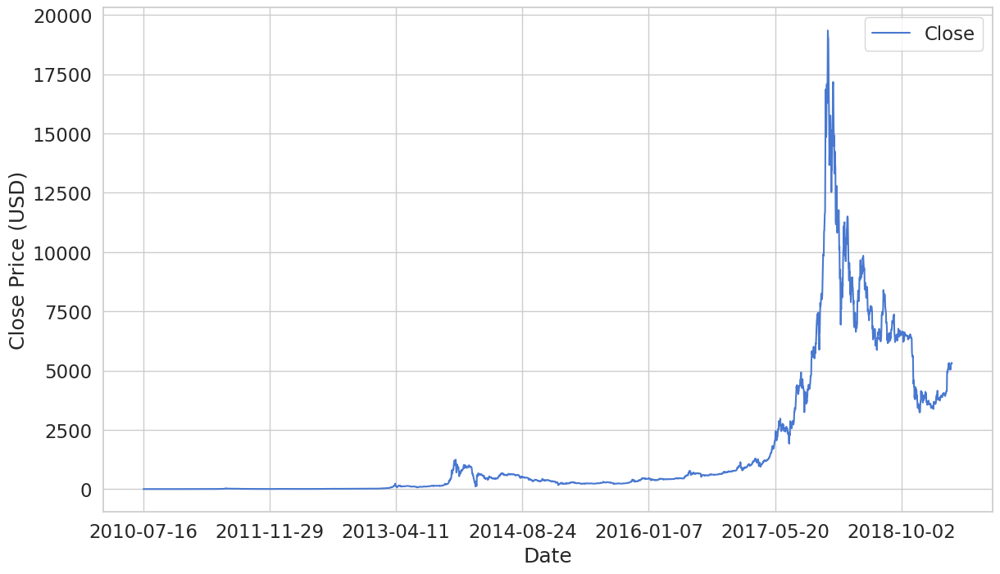

In [5]:
ax = df.plot(x='Date', y='Close')
ax.set_xlabel("Date")
ax.set_ylabel("Close Price (USD)")

In [6]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [7]:
del df['Date']
del df['High']
del df['Low']
del df['Adj Close']
del df['Volume']

In [8]:
from sklearn.preprocessing import MinMaxScaler

In [9]:
def normalize_data(df):
  close_scaler = MinMaxScaler()

  close_price = df.Close.values.reshape(-1, 1)

  scaled_close = close_scaler.fit_transform(close_price)

  
  open_scaler = MinMaxScaler()

  open_price = df.Open.values.reshape(-1, 1)

  scaled_open = open_scaler.fit_transform(open_price)

  df['Open'] = scaled_open
  df['Close'] = scaled_close

  return df, close_scaler

In [10]:
def split_sequences(seq, n_steps, device):
    X, y = [], []
    for i in range(len(seq) - n_steps):
        seq_x, seq_y = seq[i:(i + n_steps), :], seq[i + n_steps, 1]
        X.append(seq_x)
        y.append(seq_y)
    x, y = np.array(X), np.array(y)
    return torch.from_numpy(x).float().to(device), torch.from_numpy(y).float().to(device)

In [11]:
class GRUModel(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size):
        super(GRUModel, self).__init__()
        self.gru = nn.GRU(input_size, hidden_size, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size*30, output_size)
        
    def forward(self, x):
        out, _ = self.gru(x)
        out = out.contiguous().view(out.size(0),-1)
        out = self.fc(out)
        return out

In [12]:
train_prop = 0.8
test_prop = 0.1
val_prop = 0.1
n_timesteps = 30

In [13]:
# Split data into train and test sets

df_test = df[-300:]
df_test, test_close_scaler = normalize_data(df_test)
sq_test = df_test.to_numpy()

df_train = df[:-300]
df_val = df_test
df_train, _ = normalize_data(df_train)
df_val, _ = normalize_data(df_val)
sq_train = df_train.to_numpy()
sq_val = df_val.to_numpy()

X_test, y_test = split_sequences(sq_test, n_timesteps, device)
X_train, y_train = split_sequences(sq_train, n_timesteps, device)
X_valid, y_valid = split_sequences(sq_val, n_timesteps, device)

<ipython-input-9-5cb855b848e1>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Open'] = scaled_open
<ipython-input-9-5cb855b848e1>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Close'] = scaled_close
<ipython-input-9-5cb855b848e1>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#return

In [14]:
df_train

,Open,Close
0,0.000000,0.000000
1,0.000000,0.000002
2,0.000002,0.000002
3,0.000002,0.000001
4,0.000001,0.000002
...,...,...
2896,0.349479,0.347399
2897,0.347379,0.312809
2898,0.312791,0.318757
2899,0.318729,0.318304


In [15]:
class SMAPELoss(nn.Module):
    def __init__(self):
        super(SMAPELoss, self).__init__()

    def forward(self, pred, target):
        numerator = torch.abs(pred - target)
        denominator = torch.abs(pred) + torch.abs(target)
        smape = (numerator / denominator) / 2
        return torch.mean(smape)

In [16]:
# Define training parameters
input_dim = 2
hidden_dim = 64
num_layers = 1
output_dim = 1
learning_rate = 0.001
num_epochs = 500
best_loss = -1

# Instantiate RNN model
model = GRUModel(input_dim, hidden_dim, num_layers, output_dim)
model.to(device)

# Define loss function and optimizer
#criterion = SMAPELoss()
criterion_test = torch.nn.MSELoss(reduction='mean')
criterion = criterion_test
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
train_loss_plot = []
val_loss_plot = []

model.train()


# Train GRU model
for epoch in range(num_epochs):
    # Forward pass
    pred_train = model(X_train)
    pred_train = pred_train.squeeze(dim=1)
    # Compute loss
    train_loss = criterion(pred_train, y_train)

    # Backward pass and optimization
    optimizer.zero_grad()
    train_loss.backward()
    optimizer.step()

    # Print loss every 100 epochs
    if (epoch+1) % 100 == 0:
      print("Epoch [{}/{}], Loss: {:.4f}".format(epoch+1, num_epochs, train_loss.item()))
    train_loss_plot.append(train_loss)

    with torch.no_grad():
        # Forward pass
        pred_valid = model(X_valid)
        pred_valid = pred_valid.squeeze(dim=1)

        # Compute loss
        val_loss = criterion(pred_valid, y_valid)
        val_loss_plot.append(val_loss)
        if best_loss == -1 or best_loss > val_loss:
            best_loss = val_loss
            torch.save(model.state_dict(), '/content/gru_state_dict_model.pt')
            patient = 0
            best_epoch = epoch
        else:
            patient += 1
    if patient >= 100:
      break

print(best_epoch)


Epoch [100/500], Loss: 0.0009
Epoch [200/500], Loss: 0.0005
Epoch [300/500], Loss: 0.0003
Epoch [400/500], Loss: 0.0002
Epoch [500/500], Loss: 0.0002
499


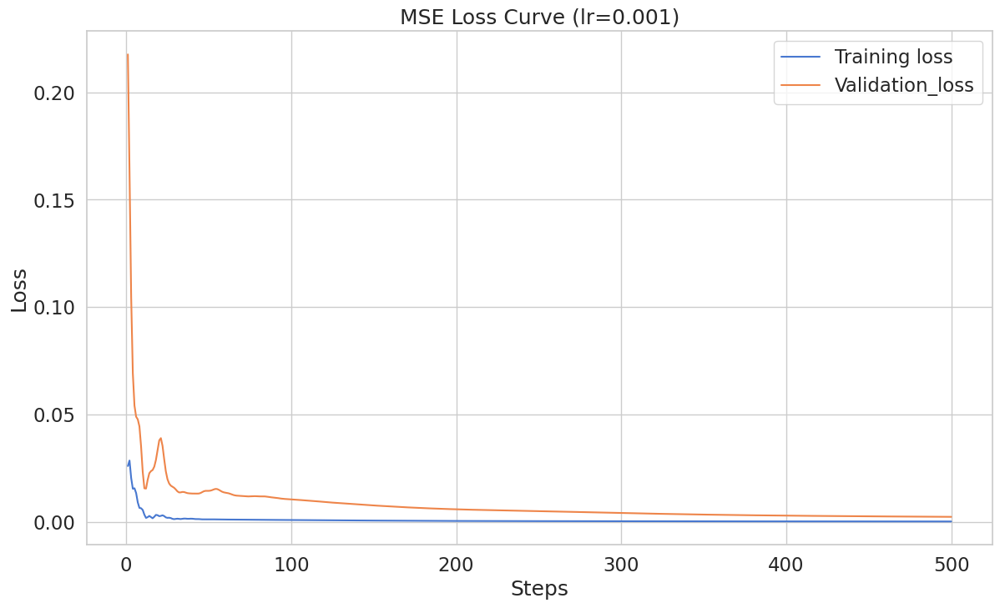

In [17]:
updates = [i for i in range(1, len(train_loss_plot) + 1)]
plt.plot(updates, torch.tensor(train_loss_plot).detach().numpy(), label="Training loss")
plt.plot(updates, torch.tensor(val_loss_plot).detach().numpy(), label="Validation_loss")
plt.title("MSE Loss Curve (lr=0.001)")
plt.xlabel("Steps")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [18]:
# Evaluate GRU model

model = GRUModel(input_dim, hidden_dim, num_layers, output_dim)
model.to(device)
model.load_state_dict(torch.load('/content/gru_state_dict_model.pt'))
model.eval()

GRUModel(
  (gru): GRU(2, 64, batch_first=True)
  (fc): Linear(in_features=1920, out_features=1, bias=True)
)

In [19]:
X_test = X_test.cpu().numpy()
y_test = y_test.cpu().numpy()

In [20]:

preds = []
labels = []
test_losses = []
total_loss = 0

for i in range(len(X_test)):
  # start extrapolating from X_test[i]
  X_test_copy = X_test.copy()
  pred = []
  label = []
  if i + 30 > len(X_test):
    break
  # auto-regressively predict the next 30 days from i
  for j in range(i, i + 30):
    #print(i, j)
    X_trapolate = X_test_copy[j:j+1,:,:]
    with torch.no_grad():
      inpt = X_trapolate
      for k in range(len(pred)):
        X_trapolate[0][-k][1] = pred[k][0]
      x_batch = (
          torch.from_numpy(inpt).float().to(device)
      )  
      output = model(x_batch)
      t = output.cpu().view(-1).numpy()
      # Produce output of the extrapolation
      pred.append(t)
      label.append([y_test[j]])

  denormalized_pred = test_close_scaler.inverse_transform(np.array(pred))
  denormalized_label = test_close_scaler.inverse_transform(np.array(label))
  test_losses.append(np.square(denormalized_pred - denormalized_label).mean())  

  preds.append(denormalized_pred)
  labels.append(denormalized_label) 


test_loss = np.mean(test_losses)        

In [21]:
print(test_loss)

214787.22


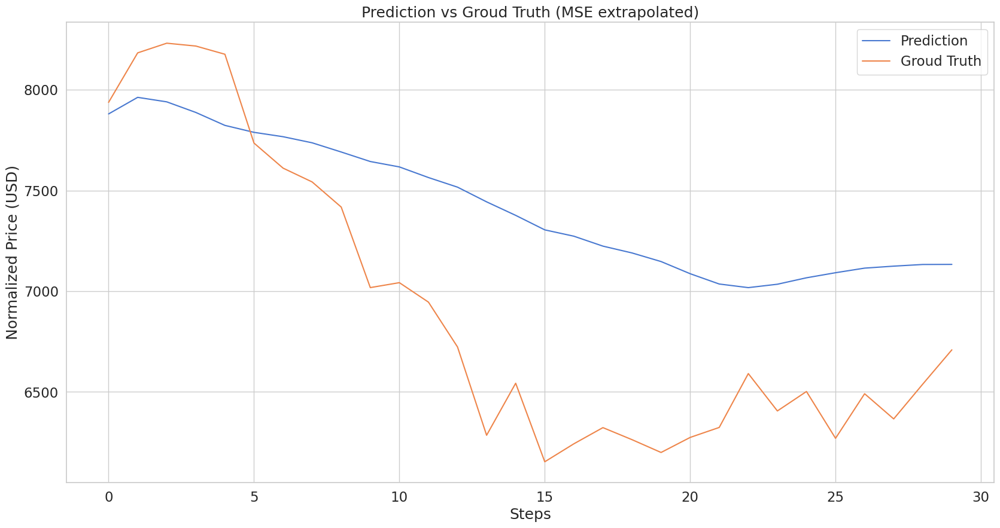

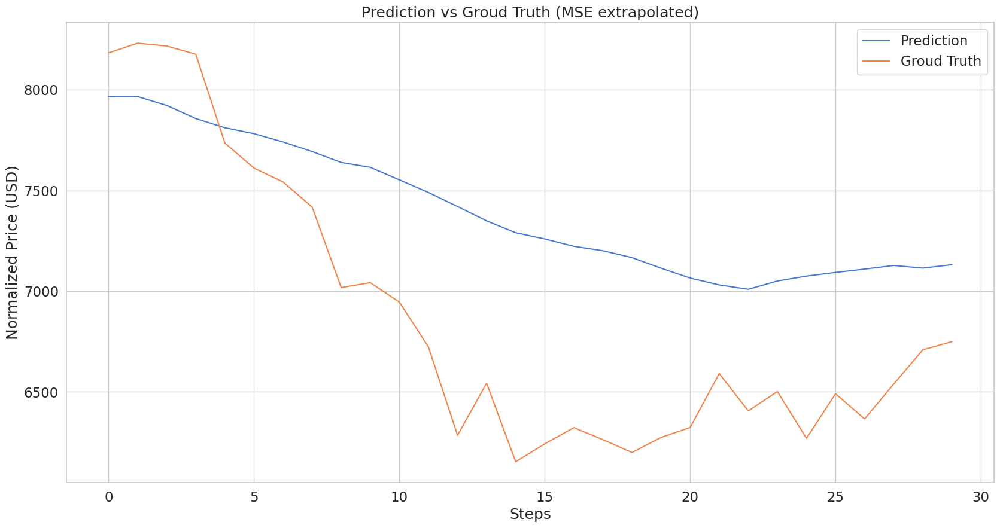

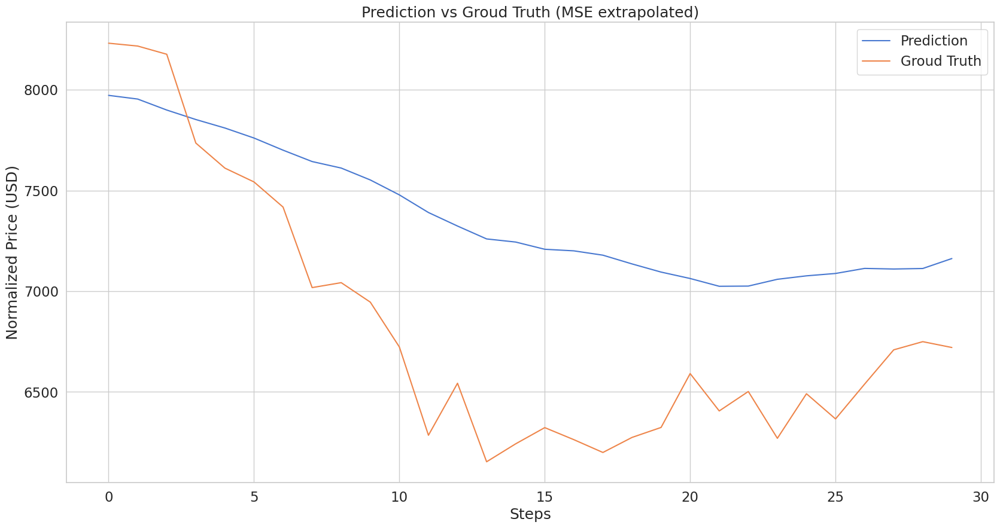

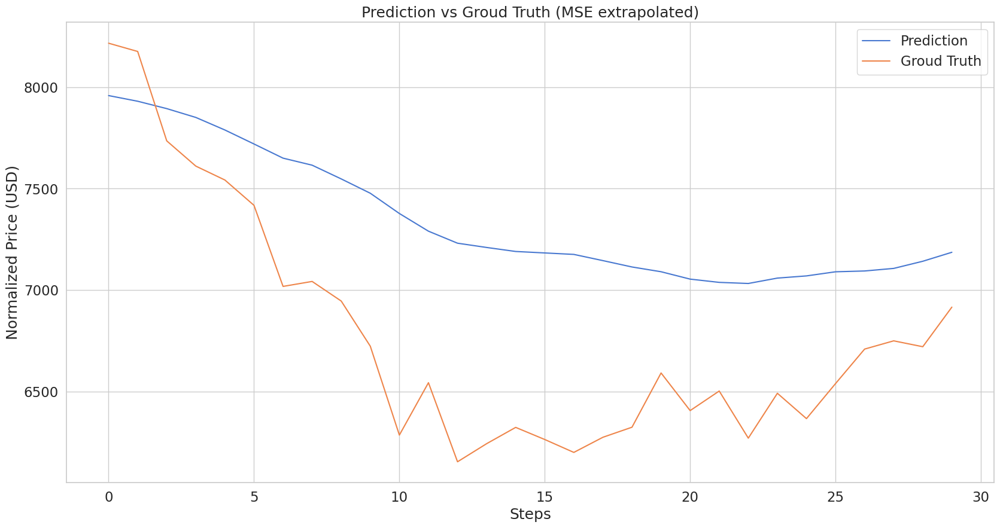

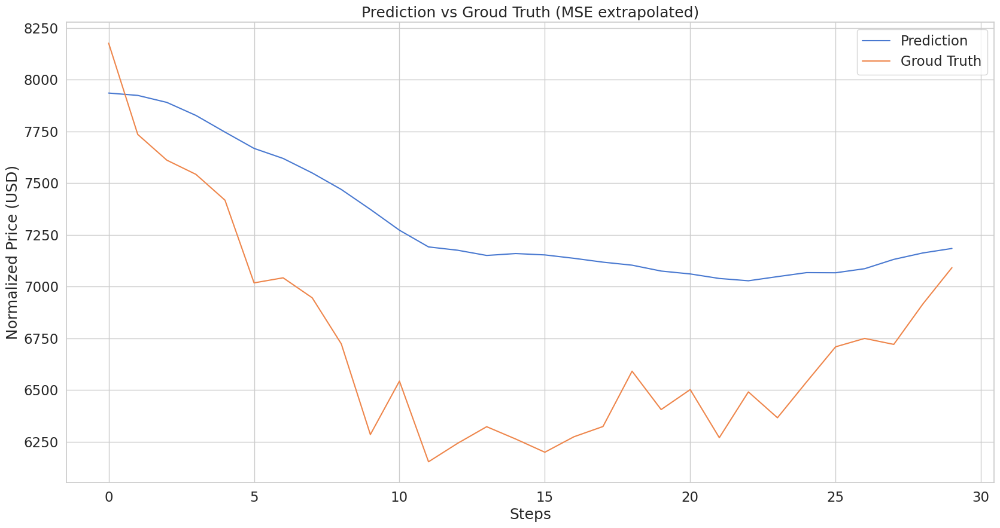

...

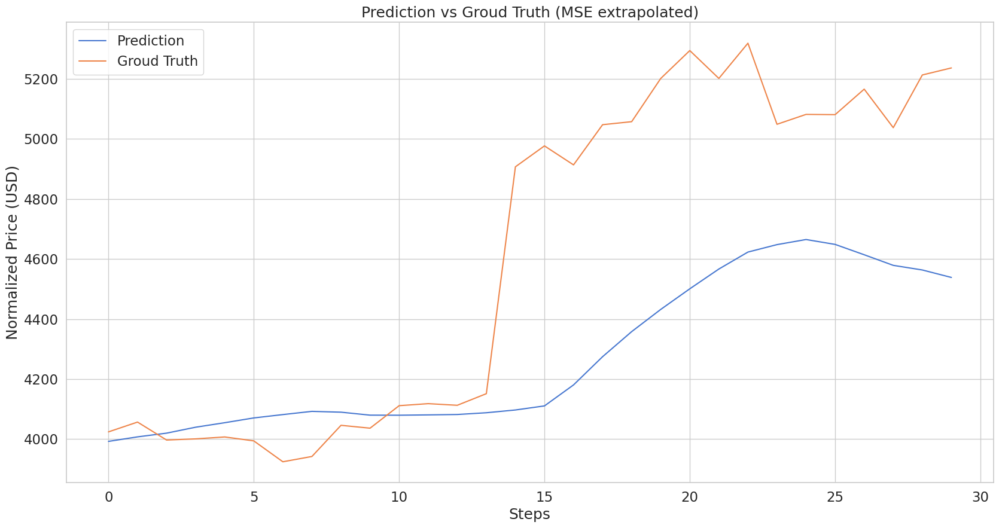

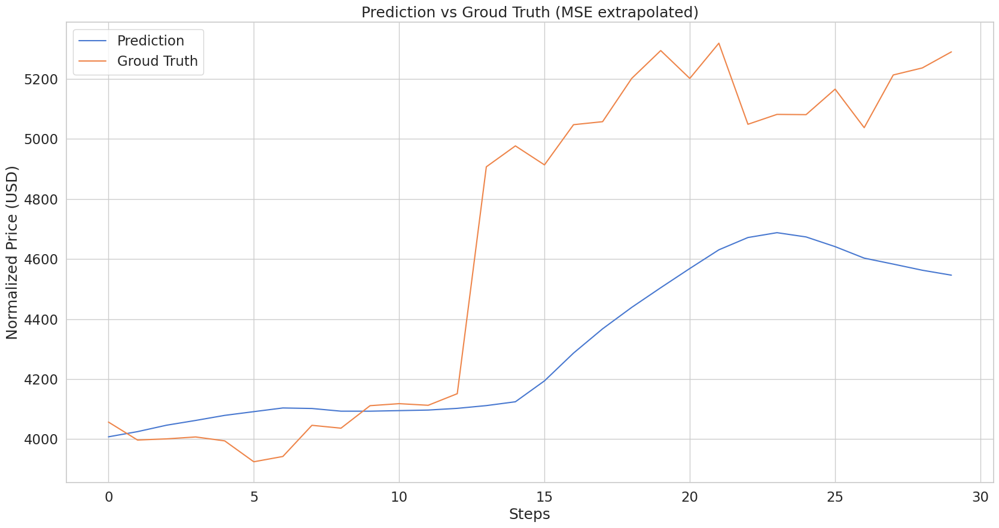

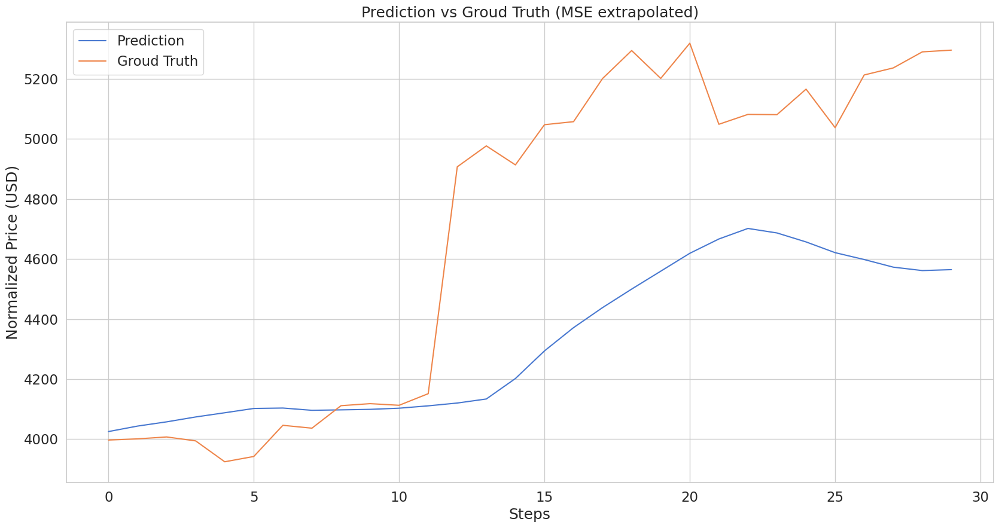

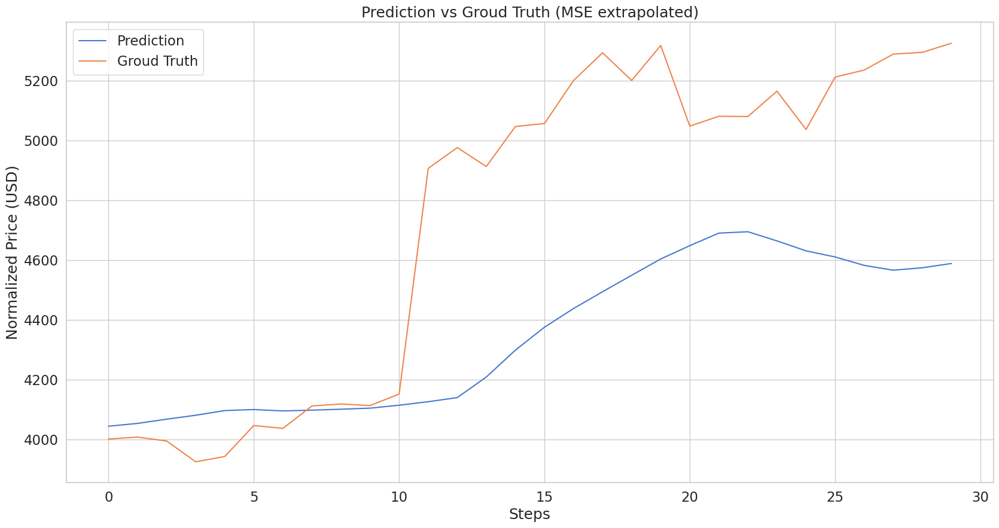

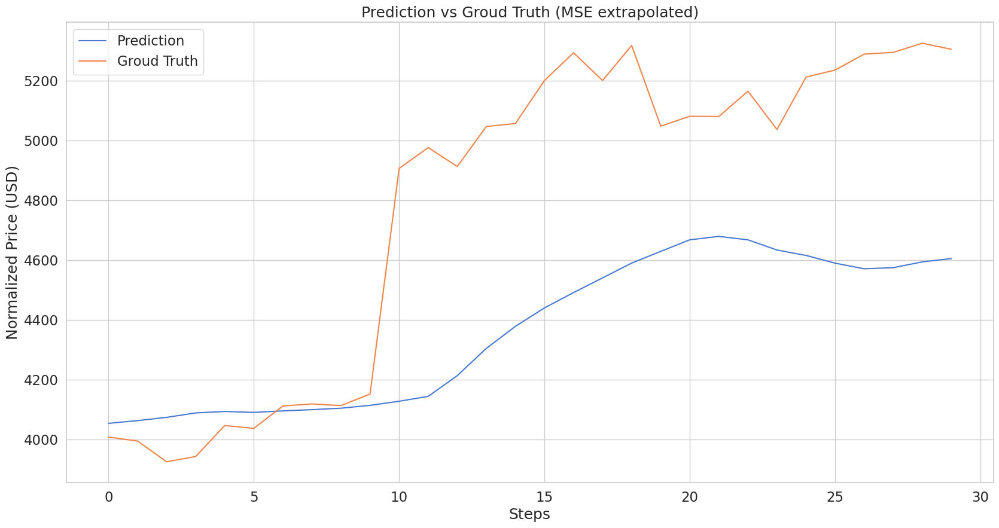

In [22]:
# Visualize preds vs labels
for j in range(len(preds)):
  pred = preds[j]
  label = labels[j]
  updates = [i for i in range(len(pred))]
  plt.figure(figsize=(20, 10))
  plt.plot(updates, pred, label="Prediction")
  plt.plot(updates, label, label="Groud Truth")
  plt.title("Prediction vs Groud Truth (MSE extrapolated)")
  plt.xlabel("Steps")
  plt.ylabel("Normalized Price (USD)")
  plt.legend()
  plt.show()
  #plt.savefig('')